In [1]:
from torchvision.datasets import ImageFolder
import torchvision.transforms as transforms
from torchvision import models
import torch.optim as optim
import torchvision
import torch.nn.functional as F
import torch
import torch.nn as nn

import time

import pandas as pd
import numpy as np

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

import cv2

import seaborn as sns

from torch.utils.data import Dataset, SubsetRandomSampler, DataLoader
from torchvision.utils import save_image

import os
import tqdm
from pathlib import Path
from copy import deepcopy
from collections import defaultdict
import PIL.Image as Image

import matplotlib.pyplot as plt
%matplotlib inline

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print(device)

cuda:0


# Предобученные ембеддинги картинок из ResNet

Для начала воспользуемся ембеддингами предобученной ResNet101, и попробуем кластеризовать объекты используя признаковые описания, которые нам выдала нейросеть. 

Рассмотрим методы 
- SpectralClustering
- KMeans
- AffinityPropagation
- AgglomerativeClustering

Визуализировать признаковое описание будем с помощью алгоритма T-SNE, так как PCA справляется здесь плоховато.

In [2]:
print(os.listdir())

data_dir = 'database_T2'

['.ipynb_checkpoints', 'Clustering_images.ipynb', 'database_T2', 'outputs']


In [3]:
data_path = Path('database_T2')
fnames = [str(p) for p in (data_path).glob('*.jpg')]

In [4]:
class FeaturesDataset(torch.utils.data.Dataset):
    def __init__(self, fnames, shape):
        self._fnames = fnames
        self._transform = torchvision.transforms.Compose([
            torchvision.transforms.Resize(shape),
            torchvision.transforms.ToTensor(),
            torchvision.transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
        ])

    def __getitem__(self, index):
        fname = self._fnames[index]
        img = Image.open(fname).convert('RGB')
        img = self._transform(img)

        return img

    def __len__(self):
        return len(self._fnames)

In [5]:
class FeatureExtractor:
    def __init__(self, model, device):
        self._model = model
        self._avgpool_features = None
        self._device = device
        self._model.avgpool.register_forward_hook(self._get_features)

    def get_dataset_features(self, loader):
        self._model.eval().to(self._device)
        features = []
        with tqdm.tqdm(loader) as pbar:
            for sample in pbar:
                _ = self._model(sample.to(self._device))
                features.append(self._avgpool_features)

        return np.concatenate(features)

    def _get_features(self, module, inputs, output):
        self._avgpool_features = np.squeeze(output.data.cpu().numpy(), axis=(2, 3))

In [6]:
model = torchvision.models.resnet101(pretrained=True)
model.eval();

train_dataset = FeaturesDataset(fnames, (512,512))
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size = 1, shuffle=False, num_workers = 0)
extractor = FeatureExtractor(model, device)

train_features = extractor.get_dataset_features(train_loader)

100%|████████████████████████████████████████████████████████████████████████████████| 366/366 [00:19<00:00, 18.81it/s]


In [7]:
train_df = pd.DataFrame(train_features)
train_df['ImageID'] = pd.DataFrame(fnames)
temp_cols = list(train_df.columns[:2048])
temp_cols.insert(0, 'ImageID')
train_df = train_df[temp_cols]
train_df.head()

,ImageID,0,1,2,3,4,5,6,7,8,...,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047
0,database_T2\0.jpg,0.653107,0.089368,0.335281,0.265442,0.144569,0.276261,0.222022,0.069497,1.769818,...,0.385985,0.126486,0.425525,0.320083,0.069609,0.166088,0.631641,0.255020,0.385081,0.304758
1,database_T2\1.jpg,1.216624,0.254615,0.432828,0.319191,0.241532,0.215301,0.464331,0.087573,2.054425,...,0.551319,0.206849,0.378196,0.380804,0.104523,0.106338,0.605456,0.329591,0.491234,0.082301
2,database_T2\10.jpg,0.597126,0.137910,0.112774,0.419757,0.043940,0.048388,0.111788,0.125476,0.306514,...,0.471002,0.220335,0.132578,0.396289,0.295545,0.195804,0.692027,0.416883,0.345991,0.084509
3,database_T2\100.jpg,0.549498,0.108454,0.111729,0.224814,0.433875,0.328350,0.055899,0.124122,2.479641,...,0.514787,0.243815,0.522817,0.327334,0.241895,0.141716,0.358744,0.229860,0.248399,0.781369
4,database_T2\101.jpg,0.835128,0.087297,0.579464,0.202073,0.427274,0.288022,0.119486,0.247932,3.589159,...,0.689438,0.450011,0.691976,0.315291,0.244623,0.332444,0.422834,0.309750,0.401506,0.804590


Я пробежался по картинкам и прикинул, что классов порядка 100-130. Выберем кластеризацию на 120 классов, и посмотрим как отработает метод К-средних:

Он разбивает множество элементов векторного пространства на заранее известное число кластеров k. Действие алгоритма таково, что он стремится минимизировать среднеквадратичное отклонение на точках каждого кластера. Основная идея заключается в том, что на каждой итерации перевычисляется центр масс для каждого кластера, полученного на предыдущем шаге, затем векторы разбиваются на кластеры вновь в соответствии с тем, какой из новых центров оказался ближе по выбранной метрике.

In [8]:
from sklearn.cluster import KMeans

X = train_df.drop('ImageID',axis = 'columns').values

k_means = KMeans(n_clusters=120)
k_means.fit(X)

preds = k_means.predict(X)

k_means_df = train_df.copy()

k_means_df['cluster'] = preds

In [9]:
df_subset = k_means_df.drop(['ImageID', 'cluster'],axis = 'columns').copy()
data_subset = df_subset.values

Вынести в функцию плот!!!

Explained variation per principal component: [0.14901853 0.10914885 0.07070938]


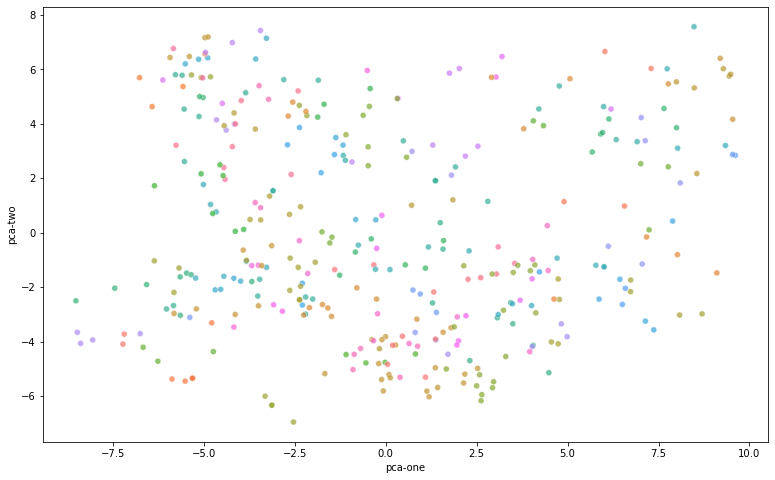

In [10]:
assert 'cluster' not in df_subset.columns
pca = PCA(n_components=3)
pca_result = pca.fit_transform(data_subset)
df_subset['pca-one'] = pca_result[:,0]
df_subset['pca-two'] = pca_result[:,1] 
df_subset['pca-three'] = pca_result[:,2]
print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))

df_subset['cluster'] = k_means_df['cluster']

plt.figure(figsize=(13,8))
sns.scatterplot(
    x="pca-one", y="pca-two",
    hue="cluster",
    palette=sns.color_palette("husl", 120),
    data=df_subset,
    legend=False,
    alpha=0.7
)
plt.show()
df_subset.drop('cluster', axis = 'columns', inplace = True)

PCA не очень справляется с визуализацией кластеризованных картинок, вероятно потому, что почти все признаки практически равозначны, и тех, которые были бы намного важнее - нет. Поэтому две первые компоненты не отражают картину близости. Попробуем метод TSNE:

Он является техникой нелинейного снижения размерности, хорошо подходящей для вложения данных высокой размерности для визуализации в пространство низкой размерности. В частности, метод моделирует каждый объект высокой размерности двух или трёхмерной точкой таким образом, что похожие объекты моделируются близко расположенными точками, а непохожие точки моделируются с большой вероятностью точками, далеко друг от друга отстоящими.

In [11]:
def plot_TSNE(df_subset, clusters, num_classes):
    data_subset = df_subset.values
    assert 'cluster' not in df_subset.columns
    time_start = time.time()
    tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
    tsne_results = tsne.fit_transform(data_subset)
    print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

    df_subset['cluster'] = clusters

    df_subset['tsne-2d-one'] = tsne_results[:,0]
    df_subset['tsne-2d-two'] = tsne_results[:,1]
    plt.figure(figsize=(13,8))
    sns.scatterplot(
        x="tsne-2d-one", y="tsne-2d-two",
        hue="cluster",
        palette=sns.color_palette("husl", num_classes),
        data=df_subset,
        legend=False,
        alpha=0.9
    )
    df_subset.drop('cluster', axis = 'columns', inplace = True)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 366 samples in 0.001s...
[t-SNE] Computed neighbors for 366 samples in 0.018s...
[t-SNE] Computed conditional probabilities for sample 366 / 366
[t-SNE] Mean sigma: 6.234189
[t-SNE] KL divergence after 250 iterations with early exaggeration: 60.673038
[t-SNE] KL divergence after 300 iterations: 0.455681
t-SNE done! Time elapsed: 0.3889586925506592 seconds


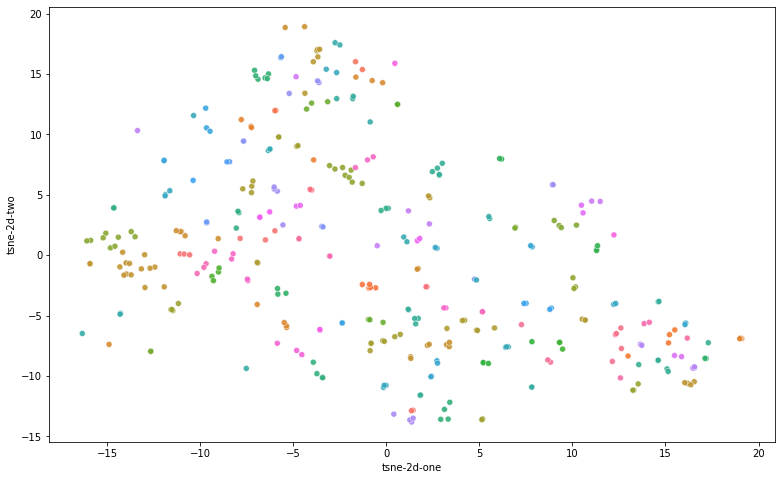

In [12]:
plot_TSNE(df_subset, k_means_df['cluster'],  len(set(k_means.labels_)))

Метод TSNE показывает намного лучший результат визуализации, что видно из графика, точки одного цвета чаще всего расположены очень близко друг к другу.

В дальнеших результатах будем пользоваться методом TSNE.

In [13]:
def visualize_samples(dataset):
    num_subplots = len(dataset['cluster'].unique())
    for cluster in dataset['cluster'].unique():
        img_clust = dataset[dataset['cluster'] == cluster]
        fig = plt.figure(figsize =(200, 200))
    
        i = 1
        for image_name in img_clust['ImageID']:
            I = cv2.imread(image_name, cv2.IMREAD_COLOR)
            I = cv2.cvtColor(I, cv2.COLOR_BGR2RGB)
            I = cv2.resize(I, (256, 256))
            ax = fig.add_subplot(1, num_subplots, i)
            ax.imshow(I)
            ax.set_title(cluster)
            i+=1

<ipython-input-93-601d00d0a656>:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize =(200, 200))


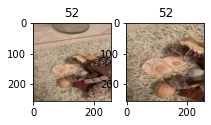

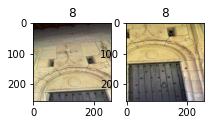

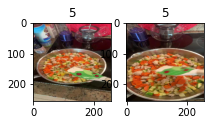

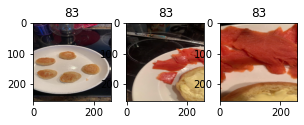

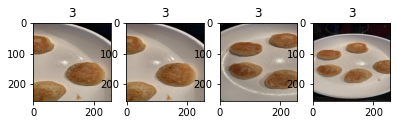

...

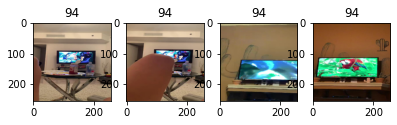

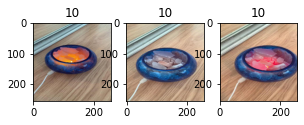

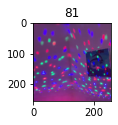

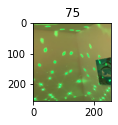

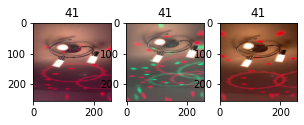

Error in callback <function flush_figures at 0x000001D3663D0AF0> (for post_execute):


KeyboardInterrupt: 

In [94]:
visualize_samples(k_means_df)

Как видно из визуализации, медот уже отлично справляется с кластеризацией обьектов, и в ошибается в очень небольшом числе случаев.

Теперь воспользуемся спектральной кластеризацией:

На практике спектральная кластеризация очень полезна, когда структура отдельных кластеров сильно невыпуклая, или в более общем случае, когда мера центра и разброса кластера не является подходящим описанием всего кластера, например, когда кластеры представляют собой вложенные круги на двумерной плоскости.

In [14]:
train_df.head()

,ImageID,0,1,2,3,4,5,6,7,8,...,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047
0,database_T2\0.jpg,0.653107,0.089368,0.335281,0.265442,0.144569,0.276261,0.222022,0.069497,1.769818,...,0.385985,0.126486,0.425525,0.320083,0.069609,0.166088,0.631641,0.255020,0.385081,0.304758
1,database_T2\1.jpg,1.216624,0.254615,0.432828,0.319191,0.241532,0.215301,0.464331,0.087573,2.054425,...,0.551319,0.206849,0.378196,0.380804,0.104523,0.106338,0.605456,0.329591,0.491234,0.082301
2,database_T2\10.jpg,0.597126,0.137910,0.112774,0.419757,0.043940,0.048388,0.111788,0.125476,0.306514,...,0.471002,0.220335,0.132578,0.396289,0.295545,0.195804,0.692027,0.416883,0.345991,0.084509
3,database_T2\100.jpg,0.549498,0.108454,0.111729,0.224814,0.433875,0.328350,0.055899,0.124122,2.479641,...,0.514787,0.243815,0.522817,0.327334,0.241895,0.141716,0.358744,0.229860,0.248399,0.781369
4,database_T2\101.jpg,0.835128,0.087297,0.579464,0.202073,0.427274,0.288022,0.119486,0.247932,3.589159,...,0.689438,0.450011,0.691976,0.315291,0.244623,0.332444,0.422834,0.309750,0.401506,0.804590


In [15]:
from sklearn.cluster import SpectralClustering

X = train_df.drop('ImageID',axis = 'columns').values

clustering = SpectralClustering(n_clusters=130,
     assign_labels='discretize',
      random_state=0).fit(X)

len(set(clustering.labels_))

62

In [16]:
spectral_df = train_df.copy()
spectral_df["cluster"] = clustering.labels_
df_subset = spectral_df.drop(['ImageID', 'cluster'],axis = 'columns').copy()

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 366 samples in 0.002s...
[t-SNE] Computed neighbors for 366 samples in 0.020s...
[t-SNE] Computed conditional probabilities for sample 366 / 366
[t-SNE] Mean sigma: 5.254567
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.954590
[t-SNE] KL divergence after 300 iterations: 0.705190
t-SNE done! Time elapsed: 0.36901211738586426 seconds


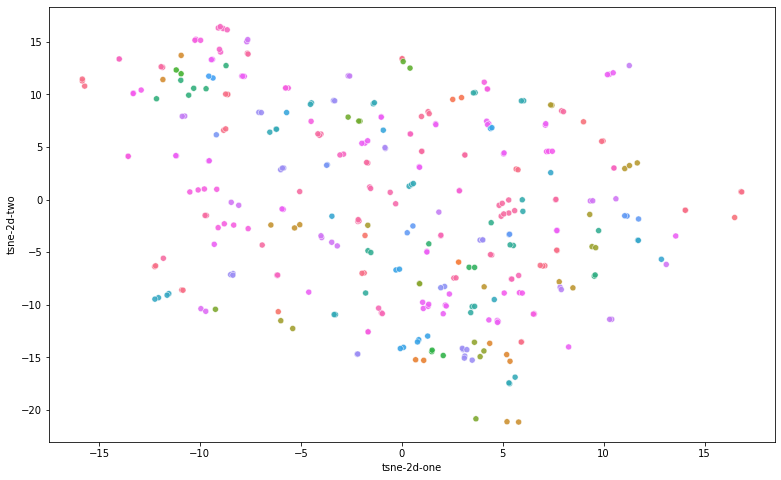

In [17]:
plot_TSNE(df_subset, spectral_df["cluster"], len(set(clustering.labels_)))

KeyboardInterrupt: 

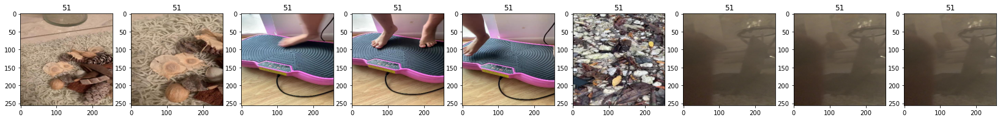

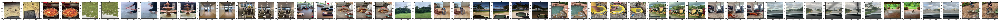

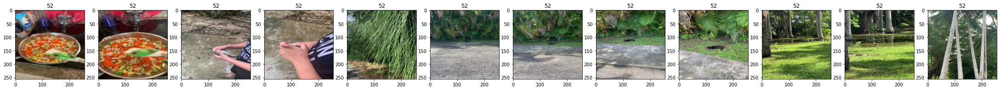

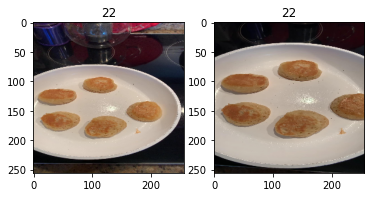

Error in callback <function flush_figures at 0x00000296AF20FB80> (for post_execute):


KeyboardInterrupt: 

In [18]:
visualize_samples(spectral_df)

Можно увидеть, что предсказания алгоритма лишь иногда соответствуют реальному разбиению на классы. Многие разноклассовые обьекты алгоритм определил как один класс. На предложенных данных он отработал достаточно плохо.

Воспользуемся теперь алгоритмом AgglomerativeClustering -- самый простой и понятный алгоритм кластеризации без фиксированного числа кластеров. Интуиция у алгоритма такая:

- Начинаем с того, что высыпаем на каждую точку свой кластер
- Сортируем попарные расстояния между центрами кластеров по возрастанию
- Берём пару ближайших кластеров, склеиваем их в один и пересчитываем центр кластера
- Повторяем п. 2 и 3 до тех пор, пока все данные не склеятся в один кластер

In [19]:
from sklearn.cluster import AgglomerativeClustering

X = train_df.drop('ImageID',axis = 'columns').values

clustering_Agg = AgglomerativeClustering(n_clusters = 120).fit(X)

len(set(clustering_Agg.labels_))

120

In [20]:
agg_df = train_df.copy()
agg_df["cluster"] = clustering_Agg.labels_
df_subset = agg_df.drop(['ImageID', 'cluster'],axis = 'columns').copy()

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 366 samples in 0.003s...
[t-SNE] Computed neighbors for 366 samples in 0.040s...
[t-SNE] Computed conditional probabilities for sample 366 / 366
[t-SNE] Mean sigma: 5.254567
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.637032
[t-SNE] KL divergence after 300 iterations: 0.627599
t-SNE done! Time elapsed: 0.4049088954925537 seconds


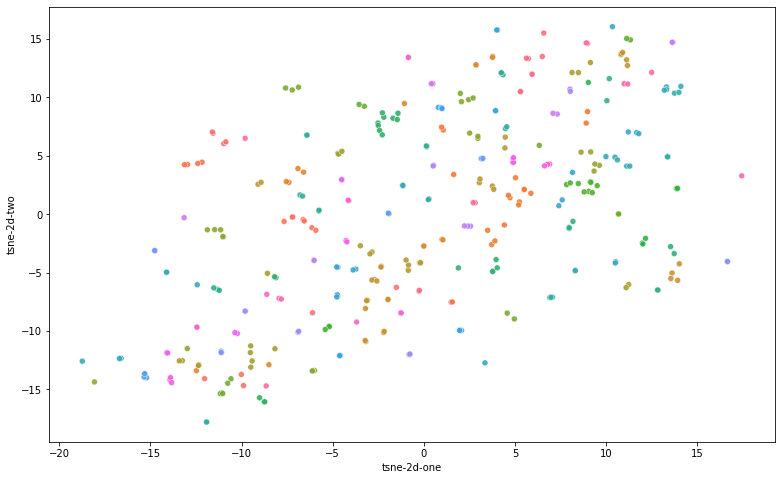

In [21]:
plot_TSNE(df_subset, agg_df["cluster"], len(set(clustering_Agg.labels_)))

<ipython-input-61-601d00d0a656>:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize =(200, 200))


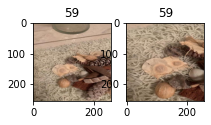

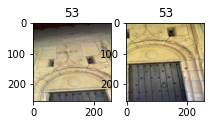

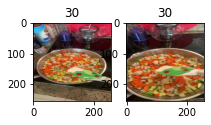

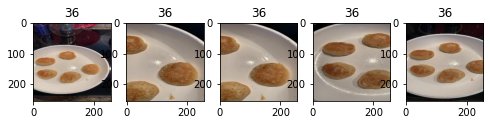

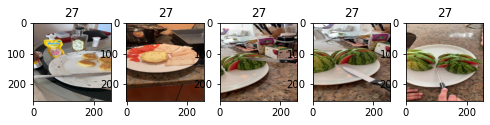

...

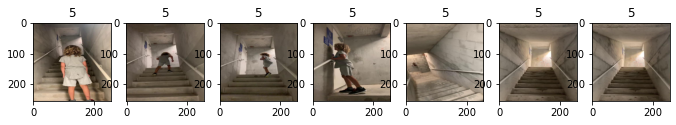

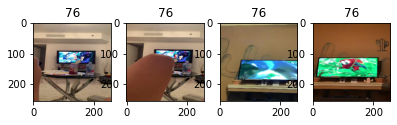

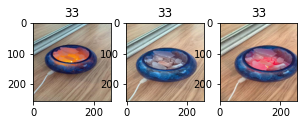

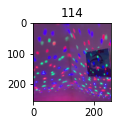

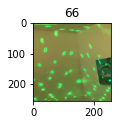

Error in callback <function flush_figures at 0x000001D3663D0AF0> (for post_execute):


KeyboardInterrupt: 

In [76]:
visualize_samples(agg_df)

Из визуализации видно, что алгоритм справился с задачей отлично, лучше kmeans или нет, сказать сложно, так как истинного вектора ответов мы не имеем, но чисто визуально алгоритм отработал отлично.

Теперь же попробуем последний из выбранных алгоритмов - AffinityPropagation - ещё один пример алгоритма кластеризации. В отличие от алгоритма KMeans, данный подход не требует заранее определять число кластеров, на которое мы хотим разбить наши данные. Основная идея алгоритма заключается в том, что нам хотелось бы, чтобы наши наблюдения кластеризовались в группы на основе того, как они "общаются", или насколько они похожи друг на друга.

In [22]:
from sklearn.cluster import AffinityPropagation

X = train_df.drop('ImageID',axis = 'columns').values

clustering_Aff = AffinityPropagation(random_state=0).fit(X)

len(set(clustering_Aff.labels_))

59

Как и алгоритм спектральной кластеризации, AffinityPropagation нашел довольно мало классов - 59. Визуализируем результаты:

In [23]:
aff_df = train_df.copy()
aff_df["cluster"] = clustering_Aff.labels_
df_subset = aff_df.drop(['ImageID', 'cluster'],axis = 'columns').copy()

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 366 samples in 0.001s...
[t-SNE] Computed neighbors for 366 samples in 0.019s...
[t-SNE] Computed conditional probabilities for sample 366 / 366
[t-SNE] Mean sigma: 5.254567
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.992805
[t-SNE] KL divergence after 300 iterations: 0.578656
t-SNE done! Time elapsed: 0.37200212478637695 seconds


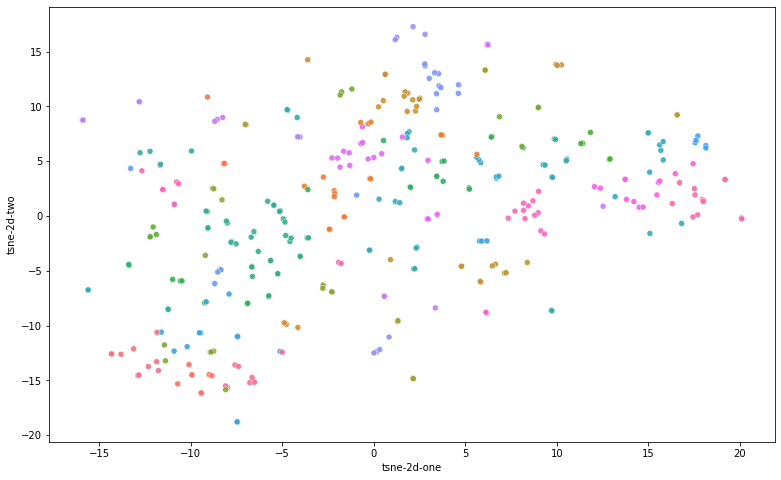

In [24]:
plot_TSNE(df_subset, aff_df["cluster"], len(set(clustering_Aff.labels_)))

<ipython-input-61-601d00d0a656>:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize =(200, 200))


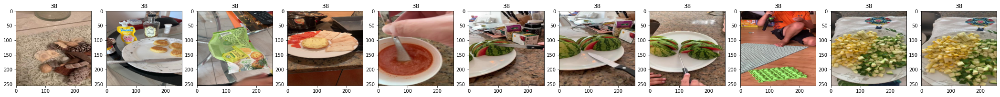

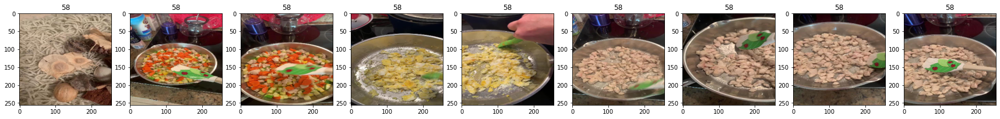

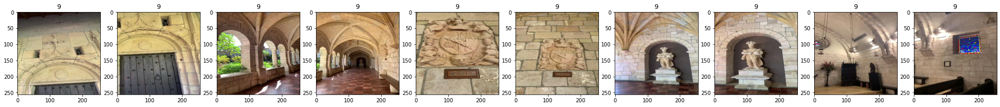

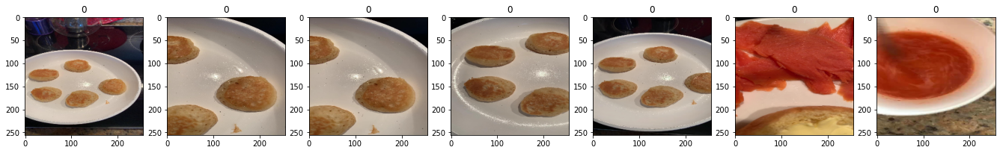

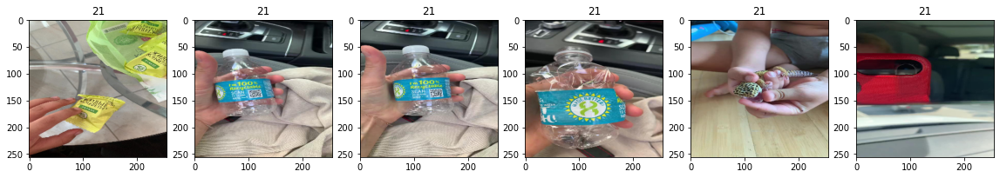

...

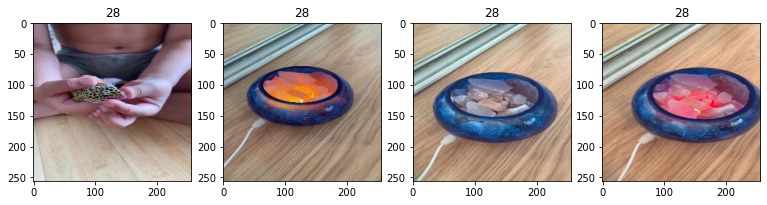

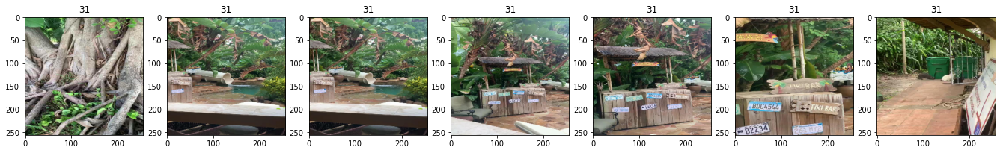

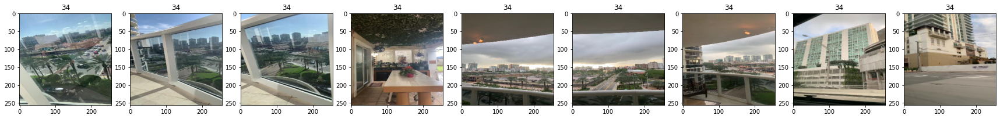

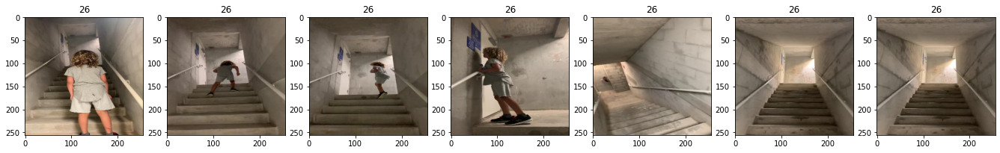

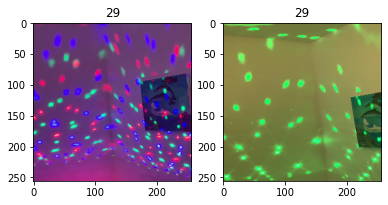

Error in callback <function flush_figures at 0x000001D3663D0AF0> (for post_execute):


KeyboardInterrupt: 

In [80]:
visualize_samples(aff_df)

# Использование автоенкодеров

Обучим автоенкодер на датастете картинок предсказывать самих себя, а потом выведем latent space, также вытащим его в датафрейм и воспользуемся методами кластеризации, описанными выше. 

Создадим собственный датасет:

In [4]:
class ImageDataset(Dataset):
    def __init__(self, folder, transform=None):
        self.transform = transform
        self.folder = folder
        self.pictures = os.listdir(folder)
                
    def __len__(self):
        return len(self.pictures)
    
    def __getitem__(self, index):        
        img_id = os.path.join(self.folder,self.pictures[index])
        img = Image.open(img_id)
        if self.transform:
            img = self.transform(img)
        return img

Определим необходимые аугментации, а также инициализируем dataloader-ы:

In [5]:
transform=transforms.Compose([
                           transforms.Resize((256, 256)),
                           transforms.RandomHorizontalFlip(),
                            transforms.RandomVerticalFlip(),
                            transforms.RandomRotation(30),
                           transforms.ToTensor(),
                           transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])                       
                       ])

transform_emb = transforms.Compose([
                           transforms.Resize((256, 256)),
                           transforms.ToTensor(),
                           transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])                       
                       ])

dataset = ImageDataset(data_dir, transform = transform)
dataset_emb = ImageDataset(data_dir, transform = transform_emb)

train_loader = torch.utils.data.DataLoader(dataset, batch_size=4, shuffle = True)
loader_for_embeds = torch.utils.data.DataLoader(dataset_emb, batch_size=1, shuffle = False)

In [6]:
class AutoEncoder(nn.Module):
    def __init__(self, init_kernel, kernel_size, stride, padding):
        super(AutoEncoder, self).__init__()
        
        #Енкодер

        self.enc1 = nn.Sequential(
           nn.Conv2d(
            in_channels=3, out_channels=init_kernel, kernel_size=kernel_size, 
            stride=stride, padding=padding),
            nn.ReLU(),
            nn.BatchNorm2d(init_kernel),
            nn.MaxPool2d(2, stride=2, return_indices=True)
        )
        
        
        self.enc2 = nn.Sequential(
           nn.Conv2d(
            in_channels=init_kernel, out_channels=init_kernel*2, kernel_size=kernel_size, 
            stride=stride, padding=padding),
            nn.ReLU(),
            nn.BatchNorm2d(init_kernel*2),
            nn.MaxPool2d(2, stride=2, return_indices=True)
        )
        
        
        self.enc3 = nn.Sequential(
           nn.Conv2d(
            in_channels=init_kernel*2, out_channels=init_kernel*4, kernel_size=kernel_size, 
            stride=stride, padding=padding),
            nn.ReLU(),
            nn.BatchNorm2d(init_kernel*4),
            nn.MaxPool2d(2, stride=2, return_indices=True)
        )
        
        
        self.enc4 = nn.Sequential(
           nn.Conv2d(
            in_channels=init_kernel*4, out_channels=init_kernel*8, kernel_size=kernel_size, 
            stride=stride, padding=padding),
            nn.ReLU(),
            nn.BatchNorm2d(init_kernel*8),
            nn.MaxPool2d(2, stride=2, return_indices=True)
        )
        
        
        self.enc5 = nn.Sequential(
           nn.Conv2d(
            in_channels=init_kernel*8, out_channels=init_kernel, kernel_size=kernel_size, 
            stride=stride, padding=padding),
            nn.ReLU(),
            nn.BatchNorm2d(init_kernel),
            nn.MaxPool2d(2, stride=2, return_indices=True)
        )
        
        # Декодер
        
        self.unpool_1 = nn.MaxUnpool2d(2, stride=2, padding=0)
        
        self.dec1 = nn.Sequential( 
            nn.ConvTranspose2d(in_channels=init_kernel, out_channels=init_kernel*8, kernel_size=kernel_size, 
            stride=stride, padding=padding), 
            nn.ReLU(),
            nn.BatchNorm2d(init_kernel*8),
        )
        
        self.unpool_2 = nn.MaxUnpool2d(2, stride=2, padding=0)
        
        self.dec2 = nn.Sequential( 
            nn.ConvTranspose2d(
            in_channels=init_kernel*8, out_channels=init_kernel*4, kernel_size=kernel_size, 
            stride=stride, padding=padding), 
            nn.ReLU(),
            nn.BatchNorm2d(init_kernel*4),
        )
        
        self.unpool_3 = nn.MaxUnpool2d(2, stride=2, padding=0)
        
        self.dec3 = nn.Sequential( 
            nn.ConvTranspose2d(
            in_channels=init_kernel*4, out_channels=init_kernel*2, kernel_size=kernel_size, 
            stride=stride, padding=padding), 
            nn.ReLU(),
            nn.BatchNorm2d(init_kernel*2),
        )
        
        self.unpool_4 = nn.MaxUnpool2d(2, stride=2, padding=0)
        
        self.dec4 = nn.Sequential( 
            nn.ConvTranspose2d(
            in_channels=init_kernel*2, out_channels=init_kernel, kernel_size=kernel_size, 
            stride=stride, padding=padding), 
            nn.ReLU(),
            nn.BatchNorm2d(init_kernel),
        )
        
        self.unpool_5 = nn.MaxUnpool2d(2, stride=2, padding=0)
        
        self.dec5 = nn.Sequential(nn.ConvTranspose2d(
            in_channels=init_kernel, out_channels=3, kernel_size=kernel_size, 
            stride=stride, padding=padding), 
            nn.ReLU(),
            nn.BatchNorm2d(3),
        )

    def reparameterize(self, mu, log_var):
        std = torch.exp(0.5*log_var)
        eps = torch.randn_like(std)
        sample = mu + (eps * std)
        return sample
 
    def forward(self, x):
        x, ind_1 = self.enc1(x)
        x, ind_2 = self.enc2(x)
        x, ind_3 = self.enc3(x)
        x, ind_4 = self.enc4(x)
        x, ind_5 = self.enc5(x)
        mu = x
        log_var = x
        # get the latent vector through reparameterization
        z = self.reparameterize(mu, log_var)
        
        
 
        x = (self.dec1(self.unpool_1(z, ind_5)))
        x = (self.dec2(self.unpool_2(x, ind_4)))
        x = (self.dec3(self.unpool_3(x, ind_3)))
        x = (self.dec4(self.unpool_4(x, ind_2)))
        reconstruction = torch.sigmoid(self.dec5(self.unpool_5(x, ind_1)))
        return reconstruction
    
    def get_embedding(self, x):
        x, ind_1 = self.enc1(x)
        x, ind_2 = self.enc2(x)
        x, ind_3 = self.enc3(x)
        x, ind_4 = self.enc4(x)
        x, ind_5 = self.enc5(x)
        return torch.flatten(x)

In [16]:
model = AutoEncoder(16, 3, 1, 1)
model.to(device);
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=20, gamma=0.7)

In [17]:
!nvidia-smi

Fri May 21 00:26:31 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 466.47       Driver Version: 466.47       CUDA Version: 11.3     |
|-------------------------------+----------------------+----------------------+
| GPU  Name            TCC/WDDM | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ... WDDM  | 00000000:01:00.0 Off |                  N/A |
| N/A   53C    P0    26W /  N/A |   1259MiB /  6144MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [18]:
n_epochs = 60

for epoch in range(1, n_epochs+1):
    train_loss = 0.0

    for data in train_loader:
        images = data
        images = images.to(device)
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, images)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()*images.size(0)
    
    scheduler.step()
          
    train_loss = train_loss/len(train_loader)
    print('Epoch: {} \tTraining Loss: {:.6f}'.format(epoch, train_loss))

Epoch: 1 	Training Loss: 6.181013
Epoch: 2 	Training Loss: 5.603465
Epoch: 3 	Training Loss: 5.352157
Epoch: 4 	Training Loss: 5.076729
Epoch: 5 	Training Loss: 5.023827
Epoch: 6 	Training Loss: 4.902631
Epoch: 7 	Training Loss: 4.814233
Epoch: 8 	Training Loss: 4.699137
Epoch: 9 	Training Loss: 4.630037
Epoch: 10 	Training Loss: 4.538804
Epoch: 11 	Training Loss: 4.455297
Epoch: 12 	Training Loss: 4.438090
Epoch: 13 	Training Loss: 4.406731
Epoch: 14 	Training Loss: 4.385380
Epoch: 15 	Training Loss: 4.357352
Epoch: 16 	Training Loss: 4.322169
Epoch: 17 	Training Loss: 4.281722
Epoch: 18 	Training Loss: 4.330828
Epoch: 19 	Training Loss: 4.324080
Epoch: 20 	Training Loss: 4.319574
Epoch: 21 	Training Loss: 4.199914
Epoch: 22 	Training Loss: 4.271293
Epoch: 23 	Training Loss: 4.267797
Epoch: 24 	Training Loss: 4.176264
Epoch: 25 	Training Loss: 4.319313
Epoch: 26 	Training Loss: 4.237289
Epoch: 27 	Training Loss: 4.310100
Epoch: 28 	Training Loss: 4.221497
Epoch: 29 	Training Loss: 4.2

KeyboardInterrupt: 

In [10]:
model.eval()
with torch.no_grad():
    embeddings = []
    i = 0
    for data in loader_for_embeds:
        images = data
        images = images.to(device)
        outputs = model(images)
        embeddings.append(model.get_embedding(images).cpu().numpy())
        img_with_pred = torch.cat((images, outputs))
        save_image(img_with_pred.cpu(), f"outputs/output{i}.png")
        i+=1

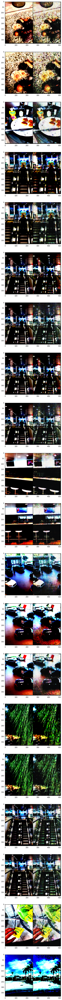

In [11]:
num_subplots = 20
fig, ax = plt.subplots(nrows=num_subplots, ncols=1, figsize=(14, num_subplots*6))
i = 0
for image_name in os.listdir('outputs/')[:20]:
    I = cv2.imread('outputs/' + image_name, cv2.IMREAD_COLOR)
    I = cv2.cvtColor(I, cv2.COLOR_BGR2RGB)
    I = cv2.resize(I, (512, 384))
        

    ax[i].imshow(I)
    i+=1

Видно, что сеть начала предсказывать картинки, хоть пока и достаточно слабо, это связано с тем, что датасет очень маленький, и сеть фактически пытается его выучить, но какое-то признаковое описание она должна выделить проходя через так называемое Bottleneck. Посмотрим, как латентное пространство автоенкодера отражает близость обьектов:

In [33]:
embeddings_df = pd.DataFrame((embeddings))
embeddings_df['ImageID'] = pd.DataFrame(fnames)

In [34]:
embeddings_df.head()

,0,1,2,3,4,5,6,7,8,9,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,ImageID
0,0.582263,0.672977,0.777400,0.749079,0.715580,1.042905,1.448717,1.417897,0.916878,0.898912,...,-0.370230,-0.571481,-0.246760,0.069523,0.029818,-0.034567,-0.694110,-0.132572,0.013288,database_T2\0.jpg
1,1.239679,1.206371,1.227123,1.017883,1.104914,1.356576,1.134170,1.076727,0.927835,0.843981,...,-1.979935,-0.695578,-0.481391,-0.485251,-0.516233,-0.355116,-1.284143,-1.979935,-1.979935,database_T2\1.jpg
2,-1.434426,-1.434426,-1.434426,-1.434426,-1.318247,-1.096858,-0.813518,-0.767082,-0.480672,-0.208529,...,0.840224,1.606894,1.003214,0.695730,0.716641,0.641069,0.537742,0.316188,0.566948,database_T2\10.jpg
3,1.515727,1.163046,0.562394,0.042033,-0.338102,0.237747,-0.227269,-0.169824,0.367509,0.768795,...,-0.029833,-0.412399,-0.542311,-0.653655,-0.947424,-1.252901,-1.062260,-0.918431,-0.948830,database_T2\100.jpg
4,-0.467334,-0.684374,-1.205454,-0.884058,-0.014920,0.569640,0.861067,1.392048,-1.434426,-1.434426,...,-0.082672,-0.421361,-0.439653,-0.055003,0.151406,-0.515270,0.028980,-0.014941,-0.023323,database_T2\101.jpg


Получили ембеддинги картинок, теперь применим к ним алгоритмы кластеризации:

In [35]:
from sklearn.cluster import KMeans

X = embeddings_df.drop('ImageID',axis = 'columns').values

k_means_with_emb = KMeans(n_clusters=120)
k_means_with_emb.fit(X)

preds_emb = k_means_with_emb.predict(X)
k_means_df_with_emb = embeddings_df.copy()
k_means_df_with_emb['cluster'] = preds_emb

In [36]:
df_subset = k_means_df_with_emb.drop(['ImageID', 'cluster'],axis = 'columns').copy()

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 366 samples in 0.001s...
[t-SNE] Computed neighbors for 366 samples in 0.007s...
[t-SNE] Computed conditional probabilities for sample 366 / 366
[t-SNE] Mean sigma: 8.300535
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.166611
[t-SNE] KL divergence after 300 iterations: 0.899791
t-SNE done! Time elapsed: 0.4089062213897705 seconds


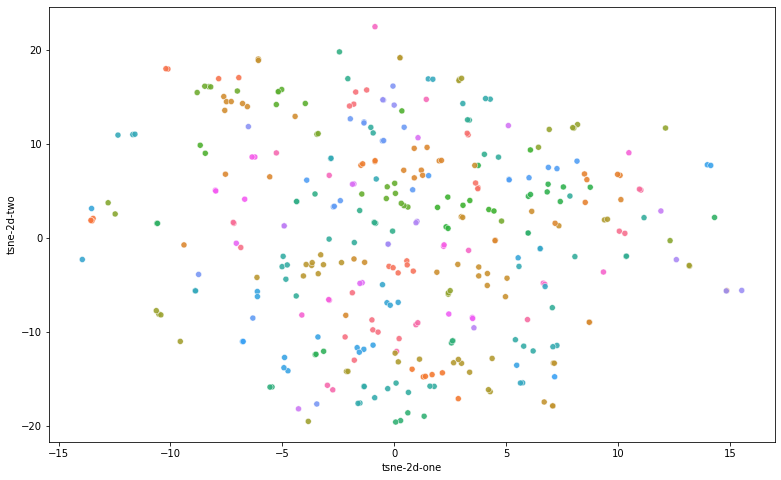

In [37]:
plot_TSNE(df_subset, k_means_df_with_emb["cluster"], len(set(k_means_with_emb.labels_)))

Видим, что есть классы, которые автоенкодер выделил хорошо, но результат в целом намного хуже чем у обычных эмеддингов классификационной сверточной сети.

<ipython-input-61-601d00d0a656>:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize =(200, 200))


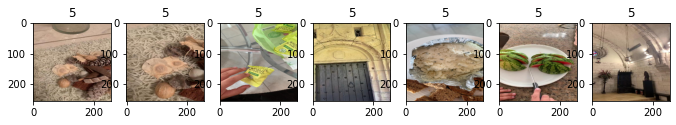

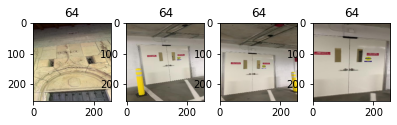

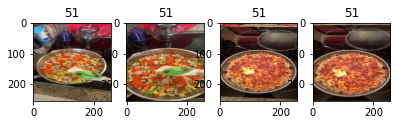

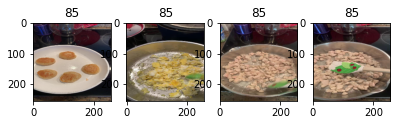

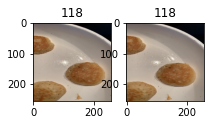

...

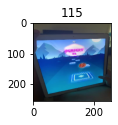

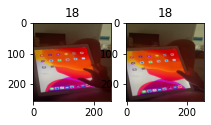

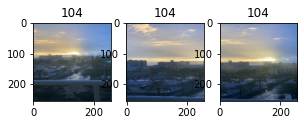

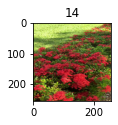

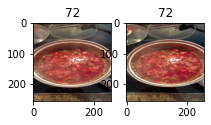

In [62]:
visualize_samples(k_means_df_with_emb)

Видно, что у сети все же получилось выделить какие-то признаки, но сделала это она не так хорошо, как например ResNet. Связано это с тем, что обобщающая способность у ResNet выше и училась она на огромном датасете, схожем по тематике с предоставленными картинками, поэтому выделять признаки она умеет хорошо. Пока что признаковое описание, полученное ResNet, с дальнейшим применением к нему методов кластеризации показывает лучший результат.

Так как эмбеддинги из автоенкодера справились хуже с описанием картинок, то прочие алгоритмы кластеризации здесь применять не имеет смысла.